<a href="https://colab.research.google.com/github/LorenaRaichle/ClinIQ/blob/main/1a_Preprocessing_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

1. Initial Setup and Imports

    Title: Initial Setup and Library Imports
    Description: This section handles the installation of necessary libraries and imports the required modules for data loading, processing, and manipulation.


In [ ]:
!pip install datasets



[notice] A new release of pip is available: 23.2.1 -> 25.1
[notice] To update, run: pip install --upgrade pip


In [ ]:
from datasets import load_dataset, Dataset, concatenate_datasets
import json
from requests.exceptions import RequestException
import time
import re
import pandas as pd
import json

#Function to check the dataset structure

In [ ]:
def check_dataset_structure(x):
    try:
        dataset = load_dataset(x)

        # Print the names of the splits
        print("Dataset splits:", dataset.keys())

        # Print number of samples in each split
        for split in dataset.keys():
            print(f"{split} size: {len(dataset[split])}")

        # Print column names (structure)
        print("Columns:", dataset["train"].column_names)

    except Exception as e:
        print(f"Unexpected error: {e}")



2. Data Loading and Transformation (Hugging Face and GitHub)

    Title: Loading and Transforming Datasets from Hugging Face and GitHub
    Description: This section focuses on fetching medical question-answering datasets from various sources, primarily Hugging Face and potentially GitHub, and transforming them into a unified format for subsequent processing.


In [ ]:
def transform_MC1_dataset():
    try:
        # Load dataset from Hugging Face
        dataset = load_dataset("bigbio/med_qa")
        transformed_data_MC1 = []
        for item in concatenate_datasets([dataset["train"], dataset["validation"], dataset["test"]]):
            # Ensure only English questions are kept
            #if item["language"] == "english":
                transformed_item = {
                    "correct_answer": item["answer_idx"],  # Convert index to A/B/C/D format
                    "options": {  # Extract only the values from option dictionary
                        "A": item["options"][0]["value"],
                        "B": item["options"][1]["value"],
                        "C": item["options"][2]["value"],
                        "D": item["options"][3]["value"],
                        "E": item["options"][4]["value"]

                    },
                    "question": item["question"],
                    "source": "MC1-bigbio/med_qa",
                    "type": "multiple_choice"
                }
                transformed_data_MC1.append(transformed_item)
        return transformed_data_MC1
    except Exception as e:
        print(f"Unexpected error: {e}")
transformed_MC1_data = transform_MC1_dataset()
print(json.dumps(transformed_MC1_data[:3], indent=4))

[
    {
        "correct_answer": "E",
        "options": {
            "A": "Ampicillin",
            "B": "Ceftriaxone",
            "C": "Ciprofloxacin",
            "D": "Doxycycline",
            "E": "Nitrofurantoin"
        },
        "question": "A 23-year-old pregnant woman at 22 weeks gestation presents with burning upon urination. She states it started 1 day ago and has been worsening despite drinking more water and taking cranberry extract. She otherwise feels well and is followed by a doctor for her pregnancy. Her temperature is 97.7\u00b0F (36.5\u00b0C), blood pressure is 122/77 mmHg, pulse is 80/min, respirations are 19/min, and oxygen saturation is 98% on room air. Physical exam is notable for an absence of costovertebral angle tenderness and a gravid uterus. Which of the following is the best treatment for this patient?",
        "source": "MC1-bigbio/med_qa",
        "type": "multiple_choice"
    },
    {
        "correct_answer": "A",
        "options": {
           

In [ ]:
def transform_MC2_dataset():
    try:
        # Load both test and validation splits
        dataset_test = load_dataset("stellalisy/mediQ",split="test")
        dataset_validation = load_dataset("stellalisy/mediQ", split="validation")

        transformed_data_MC2 = []

        # Process both splits
        for dataset in [dataset_test, dataset_validation]:
            for item in dataset:
                context = item.get("context", "")
                context = re.sub(r"[\[\]\{\}\(\)\'\"]", "", str(context)) # Remove other brackets and quotes
                transformed_item = {
                    "correct_answer": item["answer_idx"],
                    "options": item["options"],
                    "question": item["question"] + " " + context,
                    "source": "MC2-stellalisy/mediQ",
                    "type": "multiple_choice"
                }
                transformed_data_MC2.append(transformed_item)

        # Return the combined transformed data
        print(json.dumps(transformed_data_MC2[:3], indent=4))
        return transformed_data_MC2

    except Exception as e:
        print(f"Unexpected error: {e}")

# Call the function and get the length
transformed_MC2_data = transform_MC2_dataset()

[
    {
        "correct_answer": "B",
        "options": {
            "A": "Disclose the error to the patient and put it in the operative report",
            "B": "Tell the attending that he cannot fail to disclose this mistake",
            "C": "Report the physician to the ethics committee",
            "D": "Refuse to dictate the operative report"
        },
        "question": "Which of the following is the correct next action for the resident to take? A junior orthopaedic surgery resident is completing a carpal tunnel repair with the department chairman as the attending physician., During the case, the resident inadvertently cuts a flexor tendon., The tendon is repaired without complication., The attending tells the resident that the patient will do fine, and there is no need to report this minor complication that will not harm the patient, as he does not want to make the patient worry unnecessarily., He tells the resident to leave this complication out of the operative report.

In [ ]:
def transform_MC3_dataset():
    try:
        # Load dataset from Hugging Face
        dataset = load_dataset("openlifescienceai/medmcqa")  # Loads the train split directly

        transformed_data_MC3 = []

        for item in concatenate_datasets([dataset["train"], dataset["validation"], dataset["test"]]):  # Iterate directly over dataset
            # Map numerical index to letter option
            answer_mapping = {0: "A", 1: "B", 2: "C", 3: "D"}
            correct_answer = answer_mapping.get(item["cop"], None)  # Get letter option or None if not found

            transformed_item = {
                "correct_answer": correct_answer, # Use mapped answer
                "options": {
                    "A": item["opa"],
                    "B": item["opb"],
                    "C": item["opc"],
                    "D": item["opd"]
                },
                "question": item["question"],
                "source": "MC3-openlifescienceai/medmcqa",
                "type": "multiple_choice"
            }
            transformed_data_MC3.append(transformed_item)
        return transformed_data_MC3

    except RequestException as e:
        print(f"Error loading dataset: {e}")
    except Exception as e:
        print(f"Unexpected error: {e}")

# Now you can use transformed_MC3_data as before
transformed_MC3_data = transform_MC3_dataset()
print(json.dumps(transformed_MC3_data[:10], indent=4)) # Example: print first 10 entries

[
    {
        "correct_answer": "C",
        "options": {
            "A": "Hyperplasia",
            "B": "Hyperophy",
            "C": "Atrophy",
            "D": "Dyplasia"
        },
        "question": "Chronic urethral obstruction due to benign prismatic hyperplasia can lead to the following change in kidney parenchyma",
        "source": "MC3-openlifescienceai/medmcqa",
        "type": "multiple_choice"
    },
    {
        "correct_answer": "C",
        "options": {
            "A": "Vitamin C",
            "B": "Vitamin B7",
            "C": "Vitamin B12",
            "D": "Vitamin D"
        },
        "question": "Which vitamin is supplied from only animal source:",
        "source": "MC3-openlifescienceai/medmcqa",
        "type": "multiple_choice"
    },
    {
        "correct_answer": "D",
        "options": {
            "A": "Adjustable gastric banding",
            "B": "Biliopancreatic diversion",
            "C": "Duodenal Switch",
            "D": "Roux en Y Duode

In [ ]:
# Number of retry attempts
MAX_RETRIES = 3

# Attempt to load the dataset with retry logic
for attempt in range(MAX_RETRIES):
    try:
        dataset = load_dataset("UCSC-VLAA/MedReason")  # Replace with your dataset name
        break  # Exit the loop if successful
    except RequestException:
        if attempt < MAX_RETRIES - 1:
            print(f"Download attempt {attempt + 1} failed. Retrying...")
            time.sleep(5)  # Wait before retrying
        else:
            raise  # Re-raise the exception if all retries fail

transformed_data_MC4 = []

# Process each entry in the dataset
for entry in dataset['train']:
    question = entry['question'].strip()  # Assume the question is stored in the 'question' column
    #answer = entry['answer'].strip()  # Assume the answer is in the 'answer' column - not needed here
    options_raw = entry['options'].strip()  # Assume the options are in the 'options' column

    # Extract and format options
    options = {}
    for line in options_raw.split("\n"):
        if line.strip() and ". " in line:  # Check if the line is not empty and contains ". "
            choice, text = line.split(". ", 1)  # Split into choice and text
            options[choice.strip()] = text.strip()

    # Extract answer text (using string manipulation or regex)
    answer_text = entry['answer'].strip().split(".")[0]  # Split at the first "." and take the first part

    # Find the correct answer letter (using word-based matching)
    correct_answer_letter = None
    for letter, option_text in options.items():
        for word in answer_text.split():  # Iterate through words in the answer
            if word in option_text:  # Check if the word is present in the option text
                correct_answer_letter = letter
                break  # Stop searching if a match is found
        if correct_answer_letter:  # Stop searching options if a match is found
            break

    correct_answer = correct_answer_letter


    # Construct the formatted entry
    formatted_entry = {
        "correct_answer": correct_answer,  # Use the found letter
        "options": options,  # Use the formatted options dictionary
        "question": question,
        "source": "MC4-UCSC-VLAA/MedReason",
        "type": "multiple_choice"
    }
    transformed_data_MC4.append(formatted_entry)

# Print first 3 formatted entries for verification (optional)
print(json.dumps(transformed_data_MC4[:3], indent=4))

transformed_MC4_data = transformed_data_MC4

[
    {
        "correct_answer": "C",
        "options": {
            "A": "Deep transverse Perineus",
            "B": "Perinial membrane",
            "C": "Colle's fascia",
            "D": "Sphincter Urethrae"
        },
        "question": "Urogenital Diaphragm is made up of the following, except:",
        "source": "MC4-UCSC-VLAA/MedReason",
        "type": "multiple_choice"
    },
    {
        "correct_answer": "A",
        "options": {
            "A": "After 5 years",
            "B": "After 2 years",
            "C": "After 10 years",
            "D": "At the time of diagnosis"
        },
        "question": "Child with Type I Diabetes. What is the advised time for fundus examinations from the time of diagnosis?",
        "source": "MC4-UCSC-VLAA/MedReason",
        "type": "multiple_choice"
    },
    {
        "correct_answer": "A",
        "options": {
            "A": "Fecal antigen test",
            "B": "Biopsy urease test",
            "C": "Serological test",
   

In [ ]:
dataset = load_dataset("qiaojin/PubMedQA", 'pqa_artificial')
transformed_data_TF2 = [] # Initialize an empty list for True/False questions
for entry in dataset["train"]:
    question = entry['question'].strip()
    answer = entry['final_decision'].strip()
    # Convert final_decision to True/False
    transformed_answer = "True" if answer.lower() == "yes" else "False"
    # Create the formatted True/False entry
    formatted_entry = {
        "answer": transformed_answer,
        "question": question,
        "source": "TF2-qiaojin/PubMedQA",
        "type": "true_false"
    }

    transformed_data_TF2.append(formatted_entry)
transformed_TF2_data = transformed_data_TF2


In [ ]:
def transform_short_answer1_dataset():
    dataset = load_dataset("HPAI-BSC/OpenMedQA")
    transformed_data_short_answer1 = []
    for item in dataset['train']:  # Assuming 'train' split contains the data
        transformed_item = {
            "answer": item["answer"],
            "question": item["question"],
            "source": "SA1-HPAI-BSC/OpenMedQA",
            "type": "short_answer"
        }
        transformed_data_short_answer1.append(transformed_item)
    return transformed_data_short_answer1

transformed_short_answer1_data = transform_short_answer1_dataset()
print(json.dumps(transformed_short_answer1_data[:5], indent=4))

[
    {
        "answer": "Tell the attending that he cannot fail to disclose this mistake",
        "question": "A junior orthopaedic surgery resident is completing a carpal tunnel repair with the department chairman as the attending physician. During the procedure, the resident inadvertently cuts a flexor tendon, which is subsequently repaired without complication. The attending advises the resident not to report this complication in the operative report, stating that disclosure may unnecessarily worry the patient. What is the appropriate next action for the resident to take in this situation?",
        "source": "SA1-HPAI-BSC/OpenMedQA",
        "type": "short_answer"
    },
    {
        "answer": "Cross-linking of DNA",
        "question": "A 67-year-old man with transitional cell carcinoma of the bladder comes to the physician because of a 2-day history of ringing sensation in his ear. He received his first course of neoadjuvant chemotherapy 1 week ago. Pure tone audiometry shows

In [ ]:
# Load the dataset
dataset = load_dataset("Ajayaadhi/Medical-QA")

# Initialize a list to hold the reformatted entries
transformed_data_short_answer2 = []

for entry in dataset["train"]:  # Process all entries
    text = entry["train"]  # Adjust this if the key is different

    # Extract question
    question_match = re.search(r"### Input:\n(.+?)\n\[INST\]", text, re.DOTALL)
    question = question_match.group(1).strip() if question_match else ""

    # Extract answer
    answer_match = re.search(r"### Response:\n(.+?)</s>", text, re.DOTALL)
    answer = answer_match.group(1).strip() if answer_match else ""

    # Construct the reformatted entry
    reformatted_entry = {
        "question": question,
        "answer": answer,
        "source": "SA2-Ajayaadhi/Medical-QA",
        "type": "short_answer"
    }

    # Append to the list
    transformed_data_short_answer2.append(reformatted_entry)

# Print the first 3 formatted entries
transformed_short_answer2_data = transformed_data_short_answer2
print(json.dumps(transformed_short_answer1_data[:4], indent = 4))

[
    {
        "answer": "Tell the attending that he cannot fail to disclose this mistake",
        "question": "A junior orthopaedic surgery resident is completing a carpal tunnel repair with the department chairman as the attending physician. During the procedure, the resident inadvertently cuts a flexor tendon, which is subsequently repaired without complication. The attending advises the resident not to report this complication in the operative report, stating that disclosure may unnecessarily worry the patient. What is the appropriate next action for the resident to take in this situation?",
        "source": "SA1-HPAI-BSC/OpenMedQA",
        "type": "short_answer"
    },
    {
        "answer": "Cross-linking of DNA",
        "question": "A 67-year-old man with transitional cell carcinoma of the bladder comes to the physician because of a 2-day history of ringing sensation in his ear. He received his first course of neoadjuvant chemotherapy 1 week ago. Pure tone audiometry shows

3. Data Loading and Transformation (Kaggle)

    Title: Loading and Transforming Dataset from Kaggle
    Description: This section is dedicated to downloading and preparing a medical Q&A dataset obtained from Kaggle, integrating it into the standardized data structure.


In [ ]:
!pip install kaggle pandas



[notice] A new release of pip is available: 23.2.1 -> 25.1
[notice] To update, run: pip install --upgrade pip


In [ ]:
!kaggle datasets download -d thedevastator/comprehensive-medical-q-a-dataset --unzip


/Users/lorenaraichle/Developer/test/pythonProject/.venv/lib/python3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
Dataset URL: https://www.kaggle.com/datasets/thedevastator/comprehensive-medical-q-a-dataset
License(s): CC0-1.0


In [ ]:
import os
#from google.colab import auth
from kaggle.api.kaggle_api_extended import KaggleApi
# Authenticate with Kaggle API
os.environ['KAGGLE_USERNAME'] = "apfresh" # Replace with your username
os.environ['KAGGLE_KEY'] = "50af00b12093dc762e1d2d1c138dd817"
api = KaggleApi()
api.authenticate()

In [ ]:
# Load the dataset (assuming it's already available in Colab)
file_path = "/Users/lorenaraichle/Developer/NLP-project/clin_IQ/content/train.csv"
print(file_path)
dataset = pd.read_csv(file_path)

# Initialize a list to hold the reformatted entries
transformed_data_short_answer3 = []

# Iterate over the dataset entries
for index, entry in dataset.iterrows():
    question = entry.get('Question', '').strip()
    answer = entry.get('Answer', '').strip()

    response_type = "short_answer"

    # Construct the reformatted entry
    reformatted_entry = {
        "question": question,
        "answer": answer,
        "source": "SA3-thedevastator/comprehensive-medical-q-a-dataset",
        "type": "short_answer"
    }

    # Append to the list
    transformed_data_short_answer3.append(reformatted_entry)
# Convert the list to JSON format and print the first 3 entries
#print(json.dumps(transformed_data_short_answer3[:3], indent=4))
transformed_short_answer3_data = transformed_data_short_answer3
print(json.dumps(transformed_short_answer3_data[:4], indent=4))

/Users/lorenaraichle/Developer/NLP-project/clin_IQ/content/train.csv
[
    {
        "question": "Who is at risk for Lymphocytic Choriomeningitis (LCM)? ?",
        "answer": "LCMV infections can occur after exposure to fresh urine, droppings, saliva, or nesting materials from infected rodents.  Transmission may also occur when these materials are directly introduced into broken skin, the nose, the eyes, or the mouth, or presumably, via the bite of an infected rodent. Person-to-person transmission has not been reported, with the exception of vertical transmission from infected mother to fetus, and rarely, through organ transplantation.",
        "source": "SA3-thedevastator/comprehensive-medical-q-a-dataset",
        "type": "short_answer"
    },
    {
        "question": "What are the symptoms of Lymphocytic Choriomeningitis (LCM) ?",
        "answer": "LCMV is most commonly recognized as causing neurological disease, as its name implies, though infection without symptoms or mild febr

In [ ]:
!kaggle datasets download -d pythonafroz/medquad-medical-question-answer-for-ai-research --unzip


/Users/lorenaraichle/Developer/test/pythonProject/.venv/lib/python3.9/site-packages/urllib3/__init__.py:35: NotOpenSSLWarning: urllib3 v2 only supports OpenSSL 1.1.1+, currently the 'ssl' module is compiled with 'LibreSSL 2.8.3'. See: https://github.com/urllib3/urllib3/issues/3020
  warnings.warn(
Dataset URL: https://www.kaggle.com/datasets/pythonafroz/medquad-medical-question-answer-for-ai-research
License(s): CC-BY-SA-4.0


In [ ]:
# Number of retry attempts
import random
MAX_RETRIES = 3

for attempt in range(MAX_RETRIES):
    try:
        dataset = load_dataset("FreedomIntelligence/medical-o1-reasoning-SFT", "en")
        break
    except RequestException:
        if attempt < MAX_RETRIES - 1:
            print(f"Download attempt {attempt + 1} failed. Retrying...")
            time.sleep(5)
        else:
            raise

# Shuffle the dataset for randomness
data = list(dataset["train"])
random.shuffle(data)

# Helper function to format reasoning into "Step 1: ..." style
def format_reasoning_steps(text):
    sentences = re.split(r'(?<=[.!?])\s+', text.strip())
    return [f"Step {i+1}: {s}" for i, s in enumerate(sentences) if s]

# Format all entries into structured examples
transformed_multi_hop_data = []
for item in data:
    question = item["Question"].strip()
    answer = item["Response"].strip()
    reasoning_raw = item["Complex_CoT"].strip()
    reasoning_steps = format_reasoning_steps(reasoning_raw)

    transformed_multi_hop_data.append({
        "question": question,
        "answer": answer,
        "reasoning": reasoning_steps,
        "source": "MH-FreedomIntelligence/medical-o1-reasoning-SFT",
        "type": "multi_hop"
    })



# ENTIRE DATASET

4. Merging and Structuring the Full Dataset

    Title: Consolidating and Structuring the Complete Dataset
    Description: This section combines the transformed data from all sources and organizes it into a comprehensive dataset, categorized by question type (true/false, multiple choice, short answer, multi-hop).


In [ ]:
random.shuffle(transformed_TF2_data)

transformed_MC_data = transformed_MC1_data + transformed_MC2_data + transformed_MC3_data + transformed_MC4_data
random.shuffle(transformed_MC_data)

transformed_short_answer_data = transformed_short_answer1_data + transformed_short_answer2_data + transformed_short_answer3_data
random.shuffle(transformed_short_answer_data)

# drop null values
transformed_MC_data = [entry for entry in transformed_MC_data if not entry['correct_answer'] == None]

random.shuffle(transformed_multi_hop_data)



full_dataset = {
    'true_false': transformed_TF2_data,
    'multiple_choice': transformed_MC_data,
    'short_answer': transformed_short_answer_data,
    'multi_hop': transformed_multi_hop_data
}


In [ ]:
print(len(full_dataset['true_false']))
print(len(full_dataset['multiple_choice']))
print(len(full_dataset['short_answer']))
print(len(full_dataset['multi_hop']))

211269
217327
67576
19704


In [ ]:
train_dataset = {}
test_dataset = {}

for category in full_dataset:
    train_dataset[category] = full_dataset[category][:int(0.8 * len(full_dataset[category]))]
    test_dataset[category] = full_dataset[category][int(0.8 * len(full_dataset[category])):]

print("Length TF: ", len(train_dataset['true_false']))
print("Length TF: ", len(test_dataset['true_false']))
print("Length MH: ", len(train_dataset['multi_hop']))
print("Length MH: ", len(test_dataset['multi_hop']))
print("Length MC: ", len(train_dataset['multiple_choice']))
print("Length MC: ", len(test_dataset['multiple_choice']))
print("Length SA: ", len(train_dataset['short_answer']))
print("Length SA: ", len(test_dataset['short_answer']))


Length TF:  169015
Length TF:  42254
Length MH:  15763
Length MH:  3941
Length MC:  173861
Length MC:  43466
Length SA:  54060
Length SA:  13516


Deleting correct answer = null items

In [ ]:
with open("FINAL_DATASETS/full_dataset.json", "w") as f:
    json.dump(full_dataset, f, indent=4)


with open("FINAL_DATASETS/train_dataset.json", "w") as f:
    json.dump(train_dataset, f, indent=4)

with open("FINAL_DATASETS/test_dataset.json", "w") as f:
    json.dump(test_dataset, f, indent=4)

#End of the Preprocessing

Below you'll find only unused code for:

*   A different approach to saving and splitting the preprocessed data
*   Unused datasets due to a change in approach for the multi hop questions
*   Data visualizations to get an overview over question type distributions







Splitting into Train and Test Sets

  Title: Splitting the Dataset into Training and Testing Sets
  Description: This section divides the full dataset into training and testing subsets to prepare for model training and evaluation. A stratified split is used to maintain the distribution of question types in both sets.


In [ ]:
from sklearn.model_selection import train_test_split
import copy

# Step 1: Flatten all entries and label their type
all_entries = []

for q_type in full_dataset:
    for item in full_dataset[q_type]:
        item_copy = copy.deepcopy(item)
        item_copy["type"] = q_type
        all_entries.append(item_copy)

# Step 2: Create stratification labels
labels = [entry['type'] for entry in all_entries]

# Step 3: Stratified split
train_entries, test_entries = train_test_split(
    all_entries,
    test_size=0.2,
    stratify=labels,
    random_state=42
)

# Step 4: Reconstruct train and test datasets with same hierarchy
def regroup(entries):
    result = {
        'true_false': [],
        'multiple_choice': [],
        'short_answer': [],
        'multi_hop': []
    }
    for item in entries:
        item_type = item.pop("type")  # Remove 'type' to restore original format
        result[item_type].append(item)
    return result

train_dataset = regroup(train_entries)
test_dataset = regroup(test_entries)


In [ ]:
train_entries[:3]

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split

# 1. Group by Question Type
grouped_data = {}
for item in cleaned_data:  # Use the cleaned and preprocessed data
    question_type = item.get('type', 'unknown')
    grouped_data.setdefault(question_type, []).append(item)

# 2. Stratified Split within Each Group
train_data = []
test_data = []

for question_type, data in grouped_data.items():
    df = pd.DataFrame(data)

    if len(df) < 2:
        # Not enough samples to split; assign all to train
        train_data.extend(df.to_dict('records'))
        continue

    try:
        train_df, test_df = train_test_split(
            df, test_size=0.2, stratify=df['type'], random_state=42
        )
    except ValueError:
        # Fallback if stratification fails (e.g. all types are the same)
        train_df, test_df = train_test_split(df, test_size=0.2, random_state=42)

    train_data.extend(train_df.to_dict('records'))
    test_data.extend(test_df.to_dict('records'))

# 3. Result Summary
print(f"Train data size: {len(train_data)}")
print(f"Test data size: {len(test_data)}")


In [ ]:
# Format training data
train_short_answer_data = [
    {
        "input": f"Answer the following question:\n{d['question']}",
        "output": d["answer"]
    }
    for d in train_data if d['type'] == 'short_answer'
]

train_multi_hop_data = [
    {
        "input": f"Answer the following multi-hop question:\n{d['question']}",
        "output": f"{d['reasoning']}\nAnswer: {d['answer']}"
    }
    for d in train_data if d['type'] == 'multi_hop'
]

train_true_false_data = [
    {
        "input": f"Is the following statement true or false?\nStatement: {d['question']}",
        "output": d["answer"]
    }
    for d in train_data if d['type'] == 'true_false'
]

train_multiple_choice_data = [
    {
        "input": (
            f"Choose the correct option:\nQuestion: {d['question']}\nOptions:\n" +
            '\n'.join([f"{key}) {value}" for key, value in d['options'].items()])
        ),
        "output": d["correct_answer"]
    }
    for d in train_data
    if d['type'] == 'multiple_choice' and 'question' in d and 'options' in d and 'correct_answer' in d
]


# Format testing data
test_short_answer_data = [
    {
        "input": f"Answer the following question:\n{d['question']}",
        "output": d["answer"]
    }
    for d in test_data if d['type'] == 'short_answer'
]

test_multi_hop_data = [
    {
        "input": f"Answer the following multi-hop question:\n{d['question']}",
        "output": f"{d['reasoning']}\nAnswer: {d['answer']}"
    }
    for d in test_data if d['type'] == 'multi_hop'
]


test_true_false_data = [
    {
        "input": f"Is the following statement true or false?\nStatement: {d['question']}",
        "output": d["answer"]
    }
    for d in test_data if d['type'] == 'true_false'
]

test_multiple_choice_data = [
    {
        "input": (
            f"Choose the correct option:\nQuestion: {d['question']}\nOptions:\n" +
            '\n'.join([f"{key}) {value}" for key, value in d['options'].items()])
        ),
        "output": d["correct_answer"]
    }
    for d in test_data
    if d['type'] == 'multiple_choice' and 'question' in d and 'options' in d and 'correct_answer' in d
]



Save data to .zip

In [ ]:
train_data = {
    "short_answer": [],
    "true_false": [],
    "multiple_choice": [],
    "multi_hop": []
}

test_data = {
    "short_answer": [],
    "true_false": [],
    "multiple_choice": [],
    "multi_hop": []
}

# Add your transformed data to the appropriate lists:
train_data["short_answer"].extend(train_short_answer_data)
train_data["true_false"].extend(train_true_false_data)
train_data["multiple_choice"].extend(train_multiple_choice_data)
train_data["multi_hop"].extend(train_multi_hop_data)

test_data["short_answer"].extend(test_short_answer_data)
test_data["true_false"].extend(test_true_false_data)
test_data["multiple_choice"].extend(test_multiple_choice_data)
test_data["multi_hop"].extend(test_multi_hop_data)

Saving Processed Datasets to JSON and GitHub

  Title: Saving Processed Datasets and Uploading to GitHub
  Description: This section saves the partitioned training and testing datasets in JSON format and uploads them to a specified GitHub repository for storage and version control. Authentication with GitHub is handled here.


In [ ]:
import json
import zipfile

# Convert the test_data list to JSON format
json_data_1 = json.dumps(test_data, indent=4)

# Create a zip file and write the JSON data to it
with zipfile.ZipFile("test_dataset.zip", "w") as zipf:
    zipf.writestr("test_dataset.json", json_data_1)

json_data_2 = json.dumps(train_data, indent=4)

# Create a zip file and write the JSON data to it
with zipfile.ZipFile("train_dataset.zip", "w") as zipf:
    zipf.writestr("train_dataset.json", json_data_2)

print("test/train_dataset.zip created successfully!")

In [ ]:
!pip install github3.py

In [ ]:
import json
import zipfile
import github3
import os
from google.colab import userdata

# 1. Get GitHub token from Secrets
github_token = userdata.get('git')

# 2. Authenticate with GitHub
gh = github3.login(token=github_token)

# 3. Repository Information
repo_owner = 'Adria100'  # Replace with your username
repo_name = 'clin_IQ'  # Replace with your repository name

# Check if the repository exists before trying to access it
try:
    repo = gh.repository(repo_owner, repo_name)
    if repo is None:
        raise github3.exceptions.NotFoundError("Repository not found")
except github3.exceptions.NotFoundError as e:
    print(f"Error: {e}")
    # Handle the error, e.g., exit or provide instructions to the user
    exit() # You can replace this with your error handling

# 4. Function to create zip and upload to GitHub
def save_data_to_zip_and_upload(data_dict, zip_file_name):
    with zipfile.ZipFile(zip_file_name, "w") as zipf:
        for data_type, data_list in data_dict.items():
            file_name = f"{data_type}_data.json"
            with zipf.open(file_name, "w") as f:
                f.write(json.dumps(data_list, indent=4).encode())

    # Upload the zip file to GitHub
    with open(zip_file_name, "rb") as f:
        content = f.read()
        repo.create_file(
            path=f"data/processed/{zip_file_name}",  # Path in the repository
            message=f"Adding {zip_file_name}",  # Commit message
            content=content,
            branch='main'  # Replace with your branch name if needed
        )

    print(f"Uploaded {zip_file_name} to GitHub")
    os.remove(zip_file_name)  # Remove local zip file

# 5. Assuming you have train_data and test_data dictionaries populated
# ... (your code to populate train_data and test_data) ...

# 6. Save and upload the zip files
save_data_to_zip_and_upload(train_data, "train_dataset.zip")
save_data_to_zip_and_upload(test_data, "test_dataset.zip")

Outdated: Reasoning datasets that were not used in the end, due to change in approach

In [ ]:
from joblib import Memory
from tqdm.auto import tqdm
import nltk

# Download necessary NLTK data if not already downloaded
nltk.download('punkt')

# Set pad_token_id to eos_token_id for open-end generation
tokenizer.pad_token_id = tokenizer.eos_token_id

# Initialize caching
memory = Memory(location=".cache", verbose=0)

# Function to generate prompt
def generate_prompt(example):
    return f"""
    Question: {example['question']}
    Answer: {example['answer']}
    Provide a step-by-step reasoning breakdown explaining how the answer was derived.
    Each step should be clearly numbered and logically connected.
    """

# Function to extract reasoning and answer
def extract_reasoning(response):
    generated_text = response[0]["generated_text"]
    sentences = nltk.sent_tokenize(generated_text)
    answer = sentences[-1]
    reasoning = [f"Step {i+1}: {step.strip()}" for i, step in enumerate(sentences[:-1]) if step]
    return reasoning, answer

# Function to generate reasoning steps (with caching)
@memory.cache
def generate_reasoning_steps(examples):
    prompts = [generate_prompt(example) for example in examples]
    reasoning_steps = []
    answers = []
    for prompt in prompts:
        try:
            pipe = pipeline("text-generation", model=model, tokenizer=tokenizer, device_map="auto")
            response = pipe(prompt, max_new_tokens=256, do_sample=True, batch_size=4)
            reasoning, answer = extract_reasoning(response)
            reasoning_steps.append(reasoning)
            answers.append(answer)
        except Exception as e:
            print(f"Error during llama_pipeline call: {e}")
            reasoning_steps.append(["Error: Could not generate reasoning."])
            answers.append("Error: Could not generate answer.")
    return {"reasoning": reasoning_steps, "answer": answers}

# Load the dataset
dataset = load_dataset("lavita/MedQuAD", split="train")

# Apply the function to the dataset
dataset = dataset.map(generate_reasoning_steps, batched=True, batch_size=4)

# Transform the dataset to the desired format
transformed_data_R1 = []
for item in tqdm(dataset, desc="Transforming data"):
    formatted_item = {
        "answer": item["answer"],
        "question": item["question"],
        "reasoning": item["reasoning"],
        "source": {
            "isbn": "000-0000000000",
            "page": 0,
            "paragraph_id": "000-0000000000-p00-para00"
        },
        "type": "multi_hop"
    }
    transformed_data_R1.append(formatted_item)

# Print the first 3 formatted entries
print(json.dumps(transformed_data_R1[:3], indent=4))
transformed_R1_data = transformed_data_R1

In [ ]:
from datasets import load_dataset
from tqdm.auto import tqdm
import re

# Load the dataset
dataset = load_dataset("UCSC-VLAA/MedReason", split="train")

# Function to extract reasoning and answer from the "reasoning" column
def extract_reasoning_and_answer(example):
    reasoning_text = example["reasoning"]

    # Split into sections using regex
    sections = re.split(r"(Finding reasoning paths:|Reasoning Process:|Conclusion:)", reasoning_text)

    # Extract relevant parts
    reasoning_process = sections[4].strip() if len(sections) > 4 else ""
    conclusion = sections[6].strip() if len(sections) > 6 else ""

    # Combine reasoning paths and process into steps, starting from 1
    reasoning_steps = []
    step_counter = 1  # Initialize step counter

    if reasoning_process:
        for line in reasoning_process.split('\n'):
              if line.strip():  # Check if line is not empty
                    reasoning_steps.append(f"Step {step_counter}: {line.strip()}")
                    step_counter += 1  # Increment step counter

        # Extract the answer from the conclusion
        answer = conclusion.split('.')[-2].strip() if conclusion else ""  # Last sentence before trailing period

    return {"reasoning": reasoning_steps, "answer": answer}

# Apply the function to the dataset
dataset = dataset.map(extract_reasoning_and_answer)

# Transform the dataset to the desired format
transformed_data_R2 = []
for item in tqdm(dataset, desc="Transforming data"):
    formatted_item = {
        "answer": item["answer"],
        "question": item["question"],
        "reasoning": item["reasoning"],
        "source": {
            "isbn": "000-0000000000",
            "page": 0,
            "paragraph_id": "000-0000-p00-para01"  # You can adjust the paragraph_id as needed
        },
        "type": "multi_hop"
    }
    transformed_data_R2.append(formatted_item)

# Print the first 3 formatted entries
print(json.dumps(transformed_data_R2[:3], indent=4))
transformed_R2_data = transformed_data_R2

Dataset Statistics and Visualizations
  Description: This section focuses on analyzing the characteristics of the processed datasets, including the distribution of question types and the length of reasoning steps, and visualizing these statistics using plots.


In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import zipfile
import json
import numpy as np
import re

Loading Data from OneDrive

  Loading Processed Data from OneDrive
  Description: This section handles mounting a Google Drive folder and loading the previously saved processed datasets from a specified location within it.


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Update this path with the correct path to your zip file in Colab
zip_file_path = '/content/OneDrive_1_8.5.2025.zip'

with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall('/content/extracted_files') # Extract to a folder

# Access the extracted JSON files
json_file_1_path = '/content/extracted_files/test_dataset.json' # Update with your file names
json_file_2_path = '/content/extracted_files/train_dataset.json'

with open(json_file_1_path, 'r') as f1:
    test_dataset = json.load(f1)

with open(json_file_2_path, 'r') as f2:
    train_dataset = json.load(f2)



In [ ]:
print(len(test_dataset['short_answer']))
print(len(test_dataset['true_false']))
print(len(test_dataset['multiple_choice']))
print(len(test_dataset['multi_hop']))

13516
42254
43466
3941


In [ ]:
print(len(train_dataset['short_answer']))
print(len(train_dataset['true_false']))
print(len(train_dataset['multiple_choice']))
print(len(train_dataset['multi_hop']))

54060
169015
173861
15763


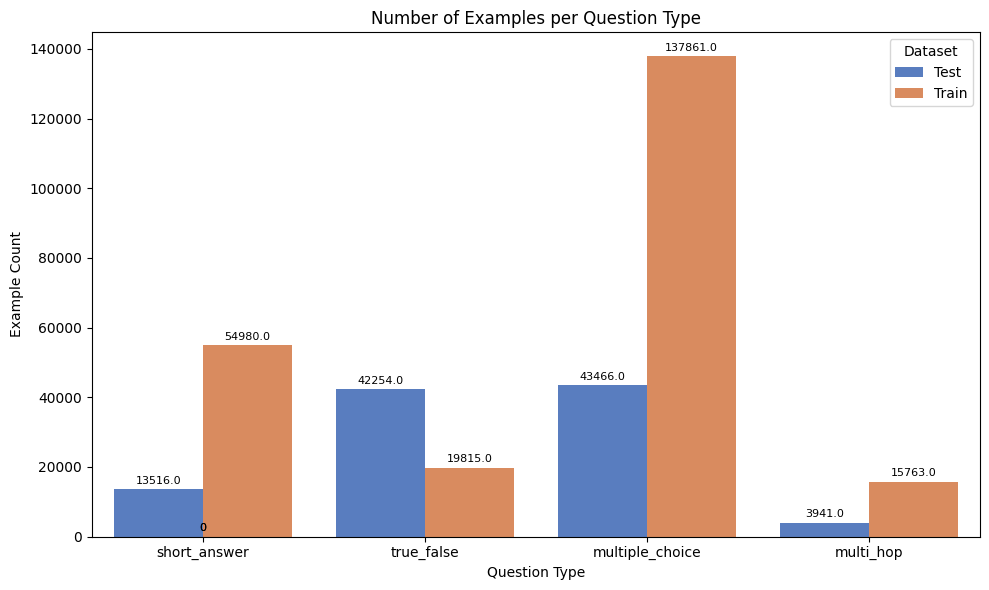

In [ ]:
# Data from your screenshot
data = {
    "Question Type": ["short_answer", "true_false", "multiple_choice", "multi_hop"] * 2,
    "Dataset": ["Test"] * 4 + ["Train"] * 4,
    "Count": [13516, 42254, 43466, 3941, 54980, 19815, 137861, 15763]
}

df_counts = pd.DataFrame(data)

# Plotting
plt.figure(figsize=(10, 6))
sns.barplot(x="Question Type", y="Count", hue="Dataset", data=df_counts, palette="muted")
plt.title("Number of Examples per Question Type")
plt.ylabel("Example Count")
plt.xlabel("Question Type")

# Annotate counts on top of bars
for bar in plt.gca().patches:
    height = bar.get_height()
    plt.gca().annotate(f'{height}', (bar.get_x() + bar.get_width() / 2, height + 1000),
                       ha='center', va='bottom', fontsize=8)

plt.tight_layout()
plt.show()


Reasoning Data

In [ ]:
# To print the first entry from train_dataset['multi_hop']:
print(json.dumps(train_dataset['multi_hop'][0], indent=4))

# To print the first entry from test_dataset['multi_hop']:
print(json.dumps(test_dataset['multi_hop'][0], indent=4))

{
    "question": "Based on a highly significant correlation coefficient (r = 0.090, p = 0.01) found between systolic blood pressure values and serum cholesterol values, what is a common misconception about the correlation in terms of the magnitude of the measurements?",
    "answer": "A common misconception regarding a highly significant correlation coefficient, such as r = 0.090 with a p-value of 0.01, is that statistical significance implies a strong or meaningful relationship between the variables involved\u2014in this case, systolic blood pressure and serum cholesterol. While the low p-value indicates that the correlation is unlikely to be due to chance, it does not reflect the strength or practical significance of the relationship. The correlation coefficient of 0.090 is quite close to zero, indicating a weak correlation, suggesting that the relationship between the two variables is not strong. Therefore, while statistically significant, the magnitude of the correlation remains v

length in steps

In [ ]:
# Assuming 'train_dataset' and 'test_dataset' are already loaded

# Function to calculate statistics for multi-hop entries
def calculate_multi_hop_stats(dataset):
    num_steps = [len(entry["reasoning"]) for entry in dataset["multi_hop"]]
    avg_steps = np.mean(num_steps)
    max_steps = np.max(num_steps)
    min_steps = np.min(num_steps)
    return avg_steps, max_steps, min_steps

# Calculate statistics for train dataset
train_avg, train_max, train_min = calculate_multi_hop_stats(train_dataset)
print("Train Dataset - Multi-hop Reasoning Statistics:")
print(f"Average steps: {train_avg:.2f}")
print(f"Maximum steps: {train_max}")
print(f"Minimum steps: {train_min}")

# Calculate statistics for test dataset
test_avg, test_max, test_min = calculate_multi_hop_stats(test_dataset)
print("\nTest Dataset - Multi-hop Reasoning Statistics:")
print(f"Average steps: {test_avg:.2f}")
print(f"Maximum steps: {test_max}")
print(f"Minimum steps: {test_min}")

Train Dataset - Multi-hop Reasoning Statistics:
Average steps: 22.08
Maximum steps: 71
Minimum steps: 9

Test Dataset - Multi-hop Reasoning Statistics:
Average steps: 22.08
Maximum steps: 53
Minimum steps: 8


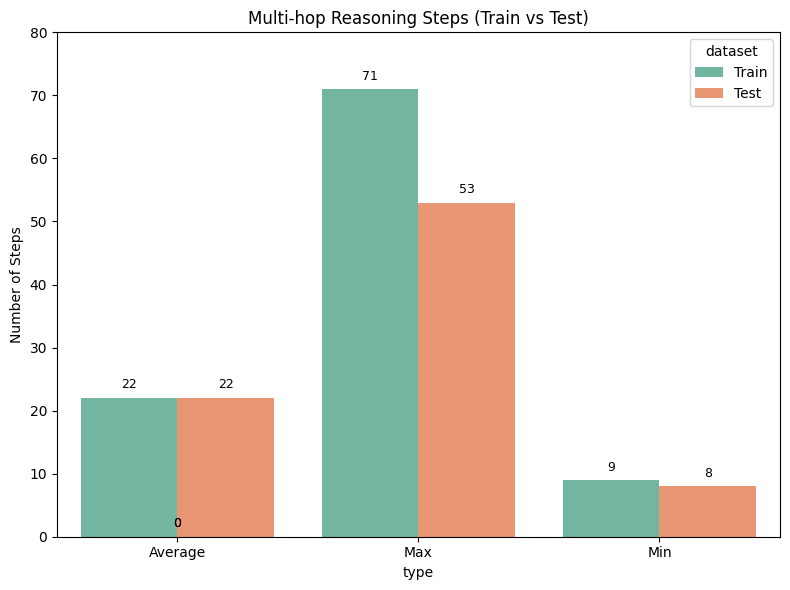

In [ ]:
# Example values (replace with your actual numbers)
train_avg, train_max, train_min = 22.08, 71, 9
test_avg, test_max, test_min = 22.08, 53, 8

# Prepare long-format DataFrame
data = {
    "dataset": ["Train", "Train", "Train", "Test", "Test", "Test"],
    "type": ["Average", "Max", "Min"] * 2,
    "steps": [train_avg, train_max, train_min, test_avg, test_max, test_min]
}
df = pd.DataFrame(data)

# Plot
plt.figure(figsize=(8, 6))
sns.barplot(x="type", y="steps", hue="dataset", data=df, palette="Set2")
plt.title("Multi-hop Reasoning Steps (Train vs Test)")
plt.ylabel("Number of Steps")
plt.ylim(0, 80)

# Annotate values
for p in plt.gca().patches:
    height = p.get_height()
    plt.gca().annotate(f'{height:.0f}', (p.get_x() + p.get_width() / 2., height + 1),
                       ha='center', va='bottom', fontsize=9)

plt.tight_layout()
plt.show()


length in characters (answers + reasoning steps)

In [ ]:
# Assuming 'train_dataset' and 'test_dataset' are already loaded
def calculate_multi_hop_char_stats(dataset):
    char_lengths = []
    for entry in dataset["multi_hop"]:
        reasoning_text = " ".join(entry["reasoning"])  # Join reasoning steps into a string
        total_text = reasoning_text + " " + entry["answer"]  # Combine reasoning and answer
        char_lengths.append(len(total_text))

    avg_length = np.mean(char_lengths)
    max_length = np.max(char_lengths)
    min_length = np.min(char_lengths)
    return avg_length, max_length, min_length

# Calculate statistics for train dataset
train_avg, train_max, train_min = calculate_multi_hop_char_stats(train_dataset)
print("Train Dataset - Multi-hop Character Length Statistics:")
print(f"Average length: {train_avg:.2f}")
print(f"Maximum length: {train_max}")
print(f"Minimum length: {train_min}")

# Calculate statistics for test dataset
test_avg, test_max, test_min = calculate_multi_hop_char_stats(test_dataset)
print("\nTest Dataset - Multi-hop Character Length Statistics:")
print(f"Average length: {test_avg:.2f}")
print(f"Maximum length: {test_max}")
print(f"Minimum length: {test_min}")

Train Dataset - Multi-hop Character Length Statistics:
Average length: 2729.62
Maximum length: 6836
Minimum length: 1033

Test Dataset - Multi-hop Character Length Statistics:
Average length: 2730.54
Maximum length: 5907
Minimum length: 1148


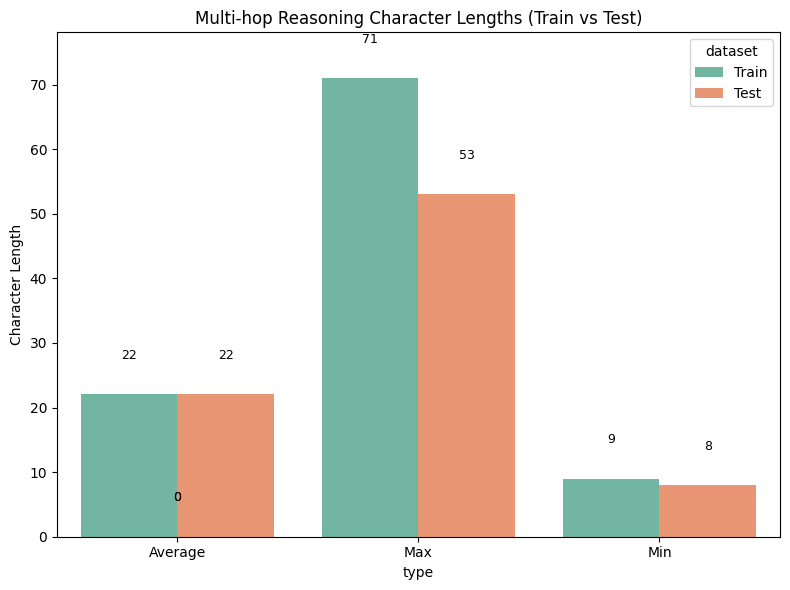

In [ ]:
# Assuming you've already defined and calculated:
# train_avg, train_max, train_min
# test_avg, test_max, test_min

# Structure data for visualization
char_stats = {
    "dataset": ["Train", "Train", "Train", "Test", "Test", "Test"],
    "type": ["Average", "Max", "Min"] * 2,
    "char_length": [train_avg, train_max, train_min, test_avg, test_max, test_min]
}

df_char = pd.DataFrame(char_stats)

# Plot
plt.figure(figsize=(8, 6))
sns.barplot(x="type", y="char_length", hue="dataset", data=df_char, palette="Set2")
plt.title("Multi-hop Reasoning Character Lengths (Train vs Test)")
plt.ylabel("Character Length")
plt.ylim(0, max(df_char["char_length"]) * 1.1)

# Annotate values
for p in plt.gca().patches:
    height = p.get_height()
    plt.gca().annotate(f'{height:.0f}', (p.get_x() + p.get_width() / 2., height + 5),
                       ha='center', va='bottom', fontsize=9)

plt.tight_layout()
plt.show()


Mulitple Choice Data

In [ ]:
# To print the first entry from train_dataset['multi_hop']:
print(json.dumps(train_dataset['multiple_choice'][0], indent=4))

# To print the first entry from test_dataset['multi_hop']:
print(json.dumps(test_dataset['multiple_choice'], indent=4))

[
    {
        "correct_answer": "B",
        "options": {
            "A": "Caput",
            "B": "Chignon",
            "C": "Phlegmon",
            "D": "None of the above."
        },
        "question": "Formation of one of the following is essential for success of this instrument?",
        "source": "MC3-openlifescienceai/medmcqa",
        "type": "multiple_choice"
    },
    {
        "correct_answer": "D",
        "options": {
            "A": "Infraspinatus Tendon",
            "B": "Middle glenohumeral ligament",
            "C": "Subscapularis Tendon",
            "D": "Supraspinatus Tendon"
        },
        "question": "The synol cavity of the glenohumeral joint communicates with the subdeltoid bursa after the rupture of:",
        "source": "MC3-openlifescienceai/medmcqa",
        "type": "multiple_choice"
    },
    {
        "correct_answer": "C",
        "options": {
            "A": "Actin",
            "B": "Myosin",
            "C": "Both",
            "D": "N

In [ ]:
# Define regex patterns for phrases you want to match
patterns = [
    r"\ball of (the )?above\b",
    r"\bnone of (the )?above\b",
    r"\bnone\b",
    r"\bany of (the )?above\b",
    r"\ball\b"
]

# Compile regexes with case-insensitive flag
compiled_patterns = [re.compile(p, re.IGNORECASE) for p in patterns]

# Count matching entries
count = 0
for entry in test_dataset['multiple_choice']:
    correct_option_key = entry["correct_answer"]
    correct_text = entry["options"].get(correct_option_key, "").strip()
    if any(p.search(correct_text) for p in compiled_patterns):
        count += 1

print("Count of matching correct answers in test_dataset:", count)


for entry in train_dataset['multiple_choice']:
    correct_option_key = entry["correct_answer"]
    correct_text = entry["options"].get(correct_option_key, "").strip()
    if any(p.search(correct_text) for p in compiled_patterns):
        count += 1

print("Count of matching correct answers in train_dataset:", count)

Count of matching correct answers in test_dataset: 1016
Count of matching correct answers in train_dataset: 5103


<ipython-input-27-c988c5963932>:33: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x="Dataset", y="Match Count", data=df_match, palette="pastel")


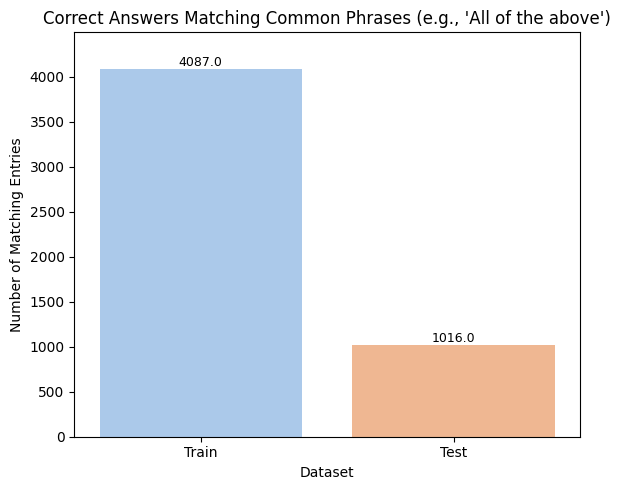

In [ ]:
# Define regex patterns for phrases
patterns = [
    r"\ball of (the )?above\b",
    r"\bnone of (the )?above\b",
    r"\bnone\b",
    r"\bany of (the )?above\b",
    r"\ball\b"
]
compiled_patterns = [re.compile(p, re.IGNORECASE) for p in patterns]

# Function to count matches in dataset
def count_matching_answers(dataset):
    count = 0
    for entry in dataset['multiple_choice']:
        correct_option_key = entry["correct_answer"]
        correct_text = entry["options"].get(correct_option_key, "").strip()
        if any(p.search(correct_text) for p in compiled_patterns):
            count += 1
    return count

# Get counts
test_count = count_matching_answers(test_dataset)
train_count = count_matching_answers(train_dataset)

# Create DataFrame for plotting
df_match = pd.DataFrame({
    "Dataset": ["Train", "Test"],
    "Match Count": [train_count, test_count]
})

# Plot
plt.figure(figsize=(6, 5))
sns.barplot(x="Dataset", y="Match Count", data=df_match, palette="pastel")
plt.title("Correct Answers Matching Common Phrases (e.g., 'All of the above')")
plt.ylabel("Number of Matching Entries")
plt.ylim(0, max(df_match["Match Count"]) * 1.1)

# Annotate bars
for p in plt.gca().patches:
    height = p.get_height()
    plt.gca().annotate(f'{height}', (p.get_x() + p.get_width() / 2., height + 1),
                       ha='center', va='bottom', fontsize=9)

plt.tight_layout()
plt.show()

# Do not run again: Balance True False Train and Testset

In [ ]:
tf_counter_trainset = [entry['answer'] for entry in trainset['true_false']]
tf_counter_testset = [entry['answer'] for entry in testset['true_false']]


In [ ]:
from collections import Counter

# Assuming tf_counter_trainset is your list of True and False values
count_result = Counter(tf_counter_trainset)

print(count_result)
print("ratio", count_result['True'] / count_result['False'])

count_result_test = Counter(tf_counter_testset)

print(count_result_test)
print("ratio", count_result_test['True'] / count_result_test['False'])

Counter({'True': 12141, 'False': 12140})
ratio 1.0000823723228995
Counter({'True': 2986, 'False': 2985})
ratio 1.0003350083752094


In [ ]:
tf_trainset = trainset['true_false']
tf_testset = testset['true_false']

tf_trainset = Dataset.from_list(tf_trainset).shuffle(seed=42)
tf_testset = Dataset.from_list(tf_testset).shuffle(seed=42)


tf_trainset_balanced = []
tf_testset_balanced = []

trainset_ctr, testset_ctr = 0, 0

for i in range(len(tf_trainset)):
  if tf_trainset[i]['answer'] == 'False':
    tf_trainset_balanced.append(tf_trainset[i])
  if tf_trainset[i]['answer'] == 'True' and trainset_ctr <= count_result['False']:
    tf_trainset_balanced.append(tf_trainset[i])
    trainset_ctr += 1


for i in range(len(tf_testset)):
  if tf_testset[i]['answer'] == 'False':
    tf_testset_balanced.append(tf_testset[i])
  if tf_testset[i]['answer'] == 'True' and testset_ctr <= count_result_test['False']:
    tf_testset_balanced.append(tf_testset[i])
    testset_ctr += 1

In [ ]:
tf_counter_trainset = [entry['answer'] for entry in tf_trainset_balanced]
tf_counter_testset = [entry['answer'] for entry in tf_testset_balanced]

In [ ]:
from collections import Counter

# Assuming tf_counter_trainset is your list of True and False values
count_result = Counter(tf_counter_trainset)

print(count_result)
print("ratio", count_result['True'] / count_result['False'])

count_result_test = Counter(tf_counter_testset)

print(count_result_test)
print("ratio", count_result_test['True'] / count_result_test['False'])

Counter({'True': 12141, 'False': 12140})
ratio 1.0000823723228995
Counter({'True': 2986, 'False': 2985})
ratio 1.0003350083752094


In [ ]:
trainset['true_false'] = tf_trainset_balanced
testset['true_false'] = tf_testset_balanced

In [ ]:
print("Trainsets:")
for split, split_data in trainset.items():
  print(f"{split}: {len(split_data)}")

print("\nTestsets:")
for split, split_data in testset.items():
  print(f"{split}: {len(split_data)}")

Trainsets:
true_false: 24281
multiple_choice: 173861
short_answer: 54060
multi_hop: 15763

Testsets:
true_false: 5971
multiple_choice: 43466
short_answer: 13516
multi_hop: 3941


In [ ]:
with open("/content/drive/MyDrive/NLP/00_Data/train_dataset_balanced_tf.json", "w") as f:
    json.dump(trainset, f, indent=4)  # indent=4 for readable formatting

with open("/content/drive/MyDrive/NLP/00_Data/test_dataset_balanced_tf.json", "w") as f:
    json.dump(testset, f, indent=4)  # indent=4 for readable formatting

# Do not run again: Reduce Multiple Choice questions to balance overall dataset

In [ ]:
mc_trainset = trainset['multiple_choice']
mc_testset = testset['multiple_choice']

mc_trainset = Dataset.from_list(mc_trainset).shuffle(seed=42)
mc_testset = Dataset.from_list(mc_testset).shuffle(seed=42)


In [ ]:
mc_trainset_balanced = []
mc_testset_balanced = []

for i in range(70000): # only take 70 000 train samples for mc
  mc_trainset_balanced.append(mc_trainset[i])
for i in range(20000): # only take 20 000 test samples for mc
  mc_testset_balanced.append(mc_testset[i])

In [ ]:
#shuffle
sa_trainset = trainset['short_answer']
sa_testset = testset['short_answer']

sa_trainset = Dataset.from_list(sa_trainset).shuffle(seed=42)
sa_testset = Dataset.from_list(sa_trainset).shuffle(seed=42)

sa_trainset = Dataset.to_list(sa_trainset)
sa_testset = Dataset.to_list(sa_testset)

#shuffle
mh_trainset = trainset['multi_hop']
mh_testset = testset['multi_hop']

mh_trainset = Dataset.from_list(mh_trainset).shuffle(seed=42)
mh_testset = Dataset.from_list(mh_trainset).shuffle(seed=42)

mh_trainset = Dataset.to_list(mh_trainset)
mh_testset = Dataset.to_list(mh_testset)

In [ ]:
trainset = {
    "true_false": trainset['true_false'],
    "multiple_choice": mc_trainset_balanced,
    "short_answer": sa_trainset,
    "multi_hop": mh_trainset
}

testset = {
    "true_false": testset['true_false'],
    "multiple_choice": mc_testset_balanced,
    "short_answer": sa_testset,
    "multi_hop": mh_testset
}

In [ ]:
print("Trainsets:")
for split, split_data in trainset.items():
  print(f"{split}: {len(split_data)}")

print("\nTestsets:")
for split, split_data in testset.items():
  print(f"{split}: {len(split_data)}")

Trainsets:
true_false: 24281
multiple_choice: 70000
short_answer: 54060
multi_hop: 15763

Testsets:
true_false: 5971
multiple_choice: 20000
short_answer: 54060
multi_hop: 15763


In [ ]:
with open("/content/drive/MyDrive/NLP/00_Data/train_dataset_balanced_shuffled.json", "w") as f:
    json.dump(trainset, f, indent=4)  # indent=4 for readable formatting

with open("/content/drive/MyDrive/NLP/00_Data/test_dataset_balanced_shuffled.json", "w") as f:
    json.dump(testset, f, indent=4)  # indent=4 for readable formatting